# WISE BPIC 2019 Analysis Notebook

This notebook shows how to use the **WISE** method on the BPIC 2019 data
directly in Python / Jupyter, including:

- selecting a subset of the log (e.g. a specific process type or document type),
- visualising the main process flow using **pm4py**,
- loading and adjusting a **process norm**,
- computing WISE scores and slice-level priorities,
- computing a **layer × slice anomaly ranking** with severity and volume,
- visualising results with tables and heatmaps.

The code cells below are written so you can paste this file into a Jupyter
notebook (or convert it with tools like `jupytext`).

---

## 0. Setup and configuration

In [1]:
# If needed, install additional dependencies in your environment.
# You typically do this once, outside the notebook, for example:
#
#   pip install jupyter pm4py plotly ipywidgets seaborn
#
# (WISE itself should already be installed in your environment.)

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import pm4py
import shap
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.ensemble import IsolationForest
import plotly.express as px


from typing import Dict, List, Optional

from wise.io.log_loader import load_event_log
from wise.io.norm_loader import load_norm_from_json
from wise.scoring.scoring import compute_case_scores
from wise.scoring.slices import aggregate_slices
from wise.norm import compute_view_weights

# Paths to data and norm
LOG_PATH = "data/BPI_Challenge_2019.csv"
NORM_PATH = "data/WISE_BPIC_Norm.json"

# Column names in the BPIC 2019 log (as produced by your pipeline)
CASE_ID_COL = "case concept:name"
ACTIVITY_COL = "event concept:name"
TIMESTAMP_COL = "event time:timestamp"

# Candidate slice dimensions (adjust to your own file)
SLICE_COLS = [
    "case Spend area text",
    "case Company",
    "case Document Type",
    "case Purch. Doc. Category",
    "case Item Type",
    "case Item Category",
    "case Spend classification text",
    "case Source",
    "case GR-Based Inv. Verif.",
    "case Goods Receipt",
]

# View to analyse (Finance / Logistics / Automation / ...)
VIEW_NAME = "Finance"

## Path settings

In [2]:
from pathlib import Path

# Where is the notebook currently running?
cwd = Path.cwd()
print("Current working dir:", cwd)

# Project root = folder that contains 'data' and 'src'
# From src/wise/analysis, that's 3 levels up
PROJECT_ROOT = cwd.parents[2]  # adjust to parents[3] if needed
print("Project root:", PROJECT_ROOT)

LOG_PATH = PROJECT_ROOT / "data" / "BPI_Challenge_2019.csv"
NORM_PATH = PROJECT_ROOT / "data" / "WISE_BPIC_Norm.json"


df_raw = pd.read_csv(LOG_PATH, encoding="latin1", low_memory=False)
print("Loaded rows:", len(df_raw))

Current working dir: /Users/ula/code/PhD/WISE/WISE/Untitled/src/wise/analysis
Project root: /Users/ula/code/PhD/WISE/WISE/Untitled
Loaded rows: 1595923


We can also filter the whole data set to a specific subset of cases.

In [3]:
import numpy as np

# -------------------------------------------------------------
# Generic filters: set USE_FILTERS=False to analyse full log
# -------------------------------------------------------------
USE_FILTERS = True

# FILTERS is a mapping: column_name -> list of acceptable values.
# You can add/remove entries as needed.
FILTERS = {
    "case Document Type": ["Standard PO"],          # e.g. Standard PO only
    # "case Source": ["Purchase order"],            # uncomment/add to refine
    # "case Company": ["companyID_0000"],           # example of restricting company
}

def apply_case_filters(df, case_id_col, filters):
    """
    Restrict a log DataFrame to cases satisfying all column filters.

    filters: dict[col -> list of values]
    """
    if not filters:
        return df.copy()

    mask = np.ones(len(df), dtype=bool)
    for col, values in filters.items():
        if col not in df.columns:
            print(f"Warning: column {col!r} not in log; skipping this filter.")
            continue
        mask &= df[col].isin(values)

    valid_cases = df.loc[mask, case_id_col].unique()
    return df[df[case_id_col].isin(valid_cases)].copy()


---

## 1. Load and inspect the event log

We first load the BPIC 2019 event log into a pandas DataFrame and run it
through `load_event_log` to normalise timestamps and check that the required
columns exist.


In [4]:
# Load raw CSV (using latin1 to avoid UnicodeDecodeError in this dataset)
df_raw = pd.read_csv(LOG_PATH, encoding="latin1", low_memory=False)
print(f"Raw log: {df_raw.shape[0]} rows, {df_raw[CASE_ID_COL].nunique()} cases")

# Normalise using WISE's loader (parses timestamps etc.)
df_log = load_event_log(
    df_raw,
    case_id_col=CASE_ID_COL,
    activity_col=ACTIVITY_COL,
    timestamp_col=TIMESTAMP_COL,
)

print(f"Normalised log: {df_log.shape[0]} events, {df_log[CASE_ID_COL].nunique()} cases")
df_log.head()

Raw log: 1595923 rows, 251734 cases
Normalised log: 1595923 events, 251734 cases


/Users/ula/code/PhD/WISE/WISE/Untitled/src/wise/io/log_loader.py:46: UserWarning: Parsing dates in %d-%m-%Y %H:%M:%S.%f format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  df[timestamp_col] = pd.to_datetime(df[timestamp_col], errors="coerce")


,eventID,case Spend area text,case Company,case Document Type,case Sub spend area text,case Purchasing Document,case Purch. Doc. Category name,case Vendor,case Item Type,case Item Category,...,case Name,case GR-Based Inv. Verif.,case Item,case concept:name,case Goods Receipt,event User,event org:resource,event concept:name,event Cumulative net worth (EUR),event time:timestamp
0,65781719105536,Sales,companyID_0000,Standard PO,Products for Resale,4507004931,Purchase order,vendorID_0670,Standard,"3-way match, invoice before GR",...,vendor_0645,False,20,4507004931_00020,True,NONE,NONE,Vendor creates invoice,68.0,1948-01-26 23:59:00
1,65777424138241,Sales,companyID_0000,Standard PO,Products for Resale,4507004931,Purchase order,vendorID_0670,Standard,"3-way match, invoice before GR",...,vendor_0645,False,10,4507004931_00010,True,NONE,NONE,Vendor creates debit memo,325.0,1948-01-26 23:59:00
2,65777424138240,Sales,companyID_0000,Standard PO,Products for Resale,4507004931,Purchase order,vendorID_0670,Standard,"3-way match, invoice before GR",...,vendor_0645,False,10,4507004931_00010,True,NONE,NONE,Vendor creates invoice,325.0,1948-01-26 23:59:00
3,65794604007424,Sales,companyID_0000,Standard PO,Products for Resale,4507004931,Purchase order,vendorID_0670,Standard,"3-way match, invoice before GR",...,vendor_0645,False,50,4507004931_00050,True,NONE,NONE,Vendor creates invoice,102.0,1948-01-26 23:59:00
4,65794604007425,Sales,companyID_0000,Standard PO,Products for Resale,4507004931,Purchase order,vendorID_0670,Standard,"3-way match, invoice before GR",...,vendor_0645,False,50,4507004931_00050,True,NONE,NONE,Vendor creates debit memo,102.0,1948-01-26 23:59:00


Optionally, inspect the available columns and unique values in the columns you
plan to use as filters or slices:

```python
df_log.columns
```

In [5]:
# Example: inspect unique values of a potential process-type column
df_log["case Document Type"].value_counts().head(20)

case Document Type
Standard PO          1539913
Framework order        33649
EC Purchase order      22361
Name: count, dtype: int64

---

## 2. Filter to a specific process type or keep all

The data provider mentioned that there are **three different types of process**.
These are typically encoded as values of a case attribute, for example:

- `case Document Type`,
- or `case Item Category`,
- or some other `case Process Type` column.

We define a generic filter that can be turned on/off.

Mathematically, we restrict the log to a subset of cases:

$$
 L' = \{ e \in L \mid f(	ext{case}(e)) \} 
 $$
where \( f \) is a Boolean predicate over case attributes.

In [6]:
# Choose a filter column and values; set USE_FILTER = False to analyse all data.
USE_FILTER = True
FILTER_COL = "case Document Type"   # adapt to your data
FILTER_VALUES = ["Standard PO", "Framework order", "EC Purchase order"]        # examples; replace with the actual types

if USE_FILTERS:
    df_sub = apply_case_filters(df_log, CASE_ID_COL, FILTERS)
    print(
        f"Filtered log: {df_sub.shape[0]} events, "
        f"{df_sub[CASE_ID_COL].nunique()} cases, "
        f"filters={FILTERS}"
    )
else:
    df_sub = df_log.copy()
    print(f"Using full log: {df_sub.shape[0]} events, {df_sub[CASE_ID_COL].nunique()} cases")



Filtered log: 1539913 events, 248755 cases, filters={'case Document Type': ['Standard PO']}


At this point, `df_sub` contains either the **full log** or a filtered subset
corresponding to one process type / document type or any combination.

---

## 3. Visualise the main process flow (pm4py)

We now use **pm4py** to visualise the main process flow (e.g., a directly
follows graph or an Inductive Petri net). We create a reduced DataFrame with
just case id, activity, and timestamp, then let pm4py discover and plot the
model.

In [7]:
# Prepare DataFrame in pm4py's expected schema
df_pm = df_sub[[CASE_ID_COL, ACTIVITY_COL, TIMESTAMP_COL]].rename(
    columns={CASE_ID_COL: "case_id", ACTIVITY_COL: "activity", TIMESTAMP_COL: "timestamp"}
)

df_pm = pm4py.format_dataframe(
    df_pm,
    case_id="case_id",
    activity_key="activity",
    timestamp_key="timestamp",
)

# Discover a directly-follows graph with start and end activities
dfg, start_activities, end_activities = pm4py.discover_dfg(df_pm)

# Visualise the DFG (works inline in Jupyter)
pm4py.view_dfg(dfg, start_activities, end_activities)


You can also discover a **Petri net** via the Inductive Miner:

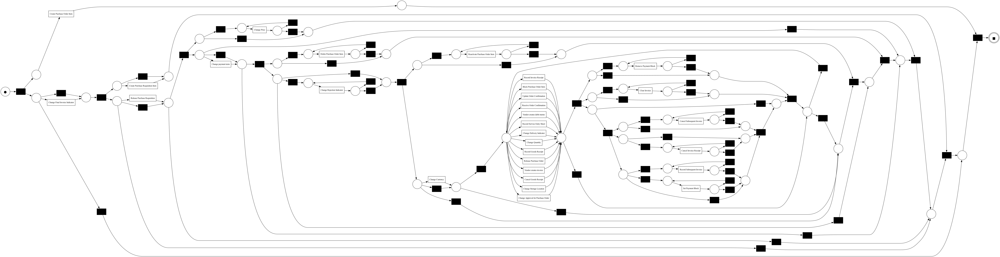

In [8]:
# Discover Petri net using Inductive Miner
log_pm = pm4py.convert_to_event_log(df_pm)
net, im, fm = pm4py.discover_petri_net_inductive(log_pm)
pm4py.view_petri_net(net, im, fm)

This gives you a high-level picture of the observed process for the selected
subset of cases. However, the process seems quite complex, so we will focus on differentating some of the most relevant types of process behaviour. From the P2P point of view, the type of document being processed is likely to have a significant impact on the process flow. 

---

### 3.2. Filter on different process types


Document type: Standard PO
  Events: 1539913, Cases: 248755
  Showing main DFG (≈80% of edge frequency)...


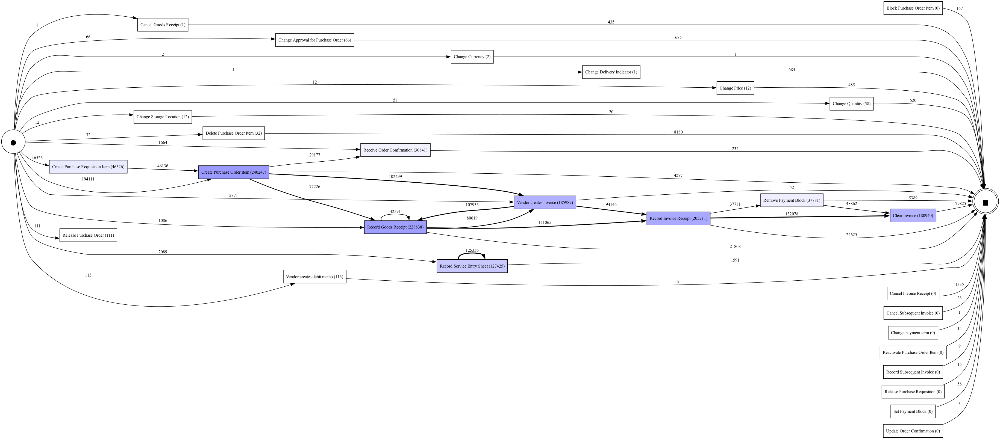


Document type: Framework order
  Events: 33649, Cases: 1539
  Showing main DFG (≈80% of edge frequency)...


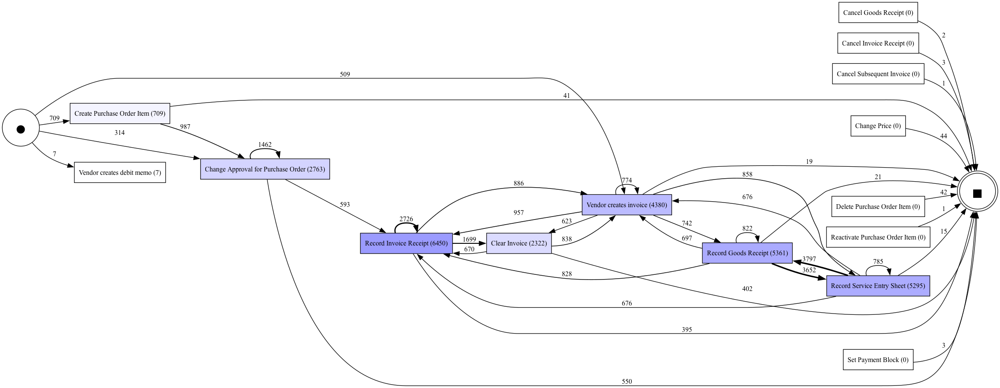


Document type: EC Purchase order
  Events: 22361, Cases: 1440
  Showing main DFG (≈80% of edge frequency)...


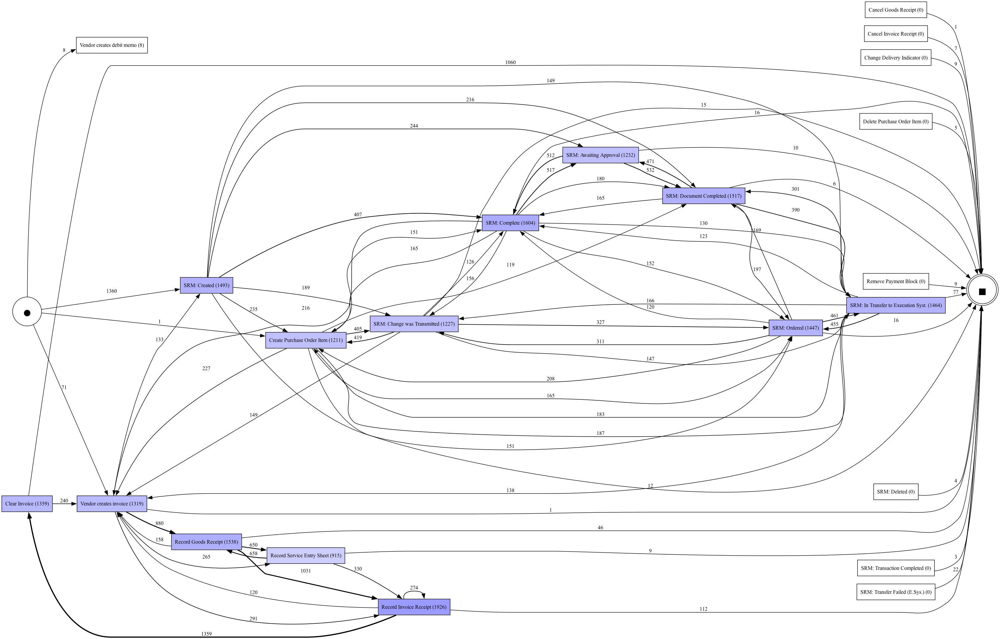

In [9]:
from pm4py.algo.filtering.dfg import dfg_filtering

def filter_dfg_by_edge_coverage(dfg, coverage: float = 0.8):
    """
    Keep the most frequent edges in a DFG until the given coverage threshold
    of total frequency is reached.

    Parameters
    ----------
    dfg : dict[(str, str), int/float]
        DFG mapping (source_activity, target_activity) -> frequency.
    coverage : float in (0,1]
        Fraction of total edge frequency to keep (e.g. 0.8 = 80%).

    Returns
    -------
    dict
        Filtered DFG with only the most important edges.
    """
    if not dfg:
        return dfg

    # sort edges by frequency, descending
    items = sorted(dfg.items(), key=lambda x: x[1], reverse=True)
    total = sum(freq for _, freq in items)
    if total <= 0:
        return dfg

    kept = {}
    cum = 0.0
    for (edge, freq) in items:
        kept[edge] = freq
        cum += freq
        if cum / total >= coverage:
            break
    return kept


for doc_type in FILTER_VALUES:
    print("\n============================")
    print(f"Document type: {doc_type}")

    # 1. Filter log to this single document type
    df_dt = df_log[df_log[FILTER_COL] == doc_type].copy()

    n_events = len(df_dt)
    n_cases = df_dt[CASE_ID_COL].nunique()
    print(f"  Events: {n_events}, Cases: {n_cases}")

    # 2. Prepare DataFrame for pm4py
    df_pm_dt = df_dt[[CASE_ID_COL, ACTIVITY_COL, TIMESTAMP_COL]].rename(
        columns={
            CASE_ID_COL: "case_id",
            ACTIVITY_COL: "activity",
            TIMESTAMP_COL: "timestamp",
        }
    )

    df_pm_dt = pm4py.format_dataframe(
        df_pm_dt,
        case_id="case_id",
        activity_key="activity",
        timestamp_key="timestamp",
    )

    # 3. Discover DFG
    dfg, start_activities, end_activities = pm4py.discover_dfg(df_pm_dt)

    # 4. Filter DFG to keep only the edges that explain ~80% of total flow
    dfg_main = filter_dfg_by_edge_coverage(dfg, coverage=0.8)

    print("  Showing main DFG (≈80% of edge frequency)...")
    pm4py.view_dfg(dfg_main, start_activities, end_activities)




Document type: Standard PO
  Events: 1539913, Cases: 248755


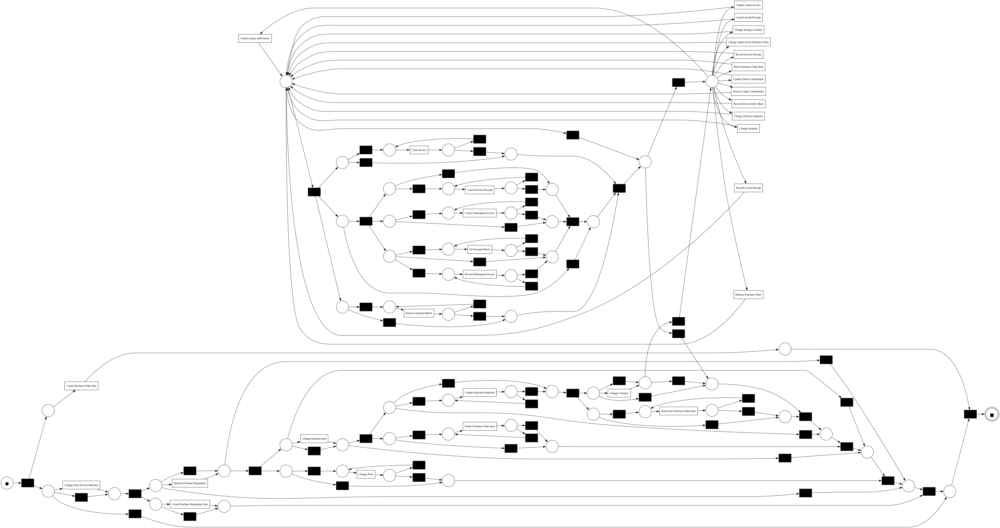


Document type: Framework order
  Events: 33649, Cases: 1539


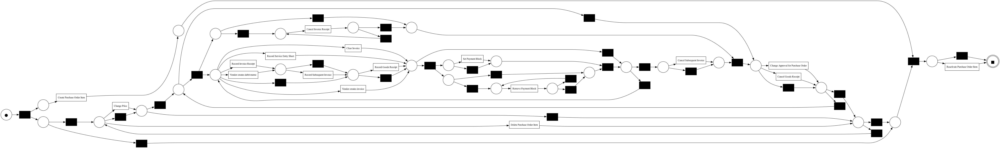


Document type: EC Purchase order
  Events: 22361, Cases: 1440


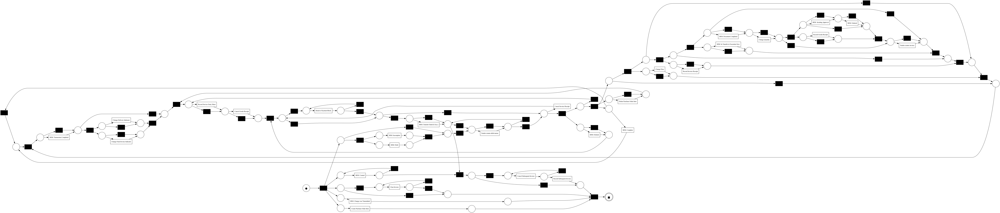

In [10]:
# Discover and show an Inductive Miner Petri net per document type
for doc_type in FILTER_VALUES:
    print("\n============================")
    print(f"Document type: {doc_type}")

    df_dt = df_log[df_log[FILTER_COL] == doc_type].copy()
    n_events = len(df_dt)
    n_cases = df_dt[CASE_ID_COL].nunique()
    print(f"  Events: {n_events}, Cases: {n_cases}")

    df_pm_dt = df_dt[[CASE_ID_COL, ACTIVITY_COL, TIMESTAMP_COL]].rename(
        columns={
            CASE_ID_COL: "case_id",
            ACTIVITY_COL: "activity",
            TIMESTAMP_COL: "timestamp",
        }
    )
    df_pm_dt = pm4py.format_dataframe(
        df_pm_dt,
        case_id="case_id",
        activity_key="activity",
        timestamp_key="timestamp",
    )
    log_dt = pm4py.convert_to_event_log(df_pm_dt)

    net, im, fm = pm4py.discover_petri_net_inductive(log_dt)
    pm4py.view_petri_net(net, im, fm)


## 4. Load the WISE norm and select a view

We now load the WISE norm from JSON and inspect the available views and
constraints.

In [11]:
with open(NORM_PATH, "r", encoding="utf-8") as f:
    norm = load_norm_from_json(f)

print("Norm views:", norm.get_view_names())
print("Number of constraints:", len(norm.constraints))

# If needed, adjust VIEW_NAME here to one of the available views.
VIEW_NAME = VIEW_NAME if VIEW_NAME in norm.get_view_names() else norm.get_view_names()[0]
print("Using view:", VIEW_NAME)

Norm views: ['Finance', 'Logistics', 'Automation']
Number of constraints: 16
Using view: Finance


Mathematically, the norm is a set of constraints $C$ over cases, grouped
into layers (presence, order/lag, balance, singularity, exclusion). For each
view $v$ we have weights $w_c^{(v)}$ per constraint, and the WISE
score for a case $\sigma$ is:

$$
S^{(v)}(\sigma) = 1 - \sum_{c \in C} w_c^{(v)}\, v_c(\sigma),
\quad S^{(v)} \in [0,1].
$$

where $v_c(\sigma)$ is a bounded violation measure for constraint $c$.

---

## 5. Compute case-level WISE scores

We compute WISE scores for the selected view using `compute_case_scores`.
This returns a DataFrame with one row per case, containing:

- `score` in `[0,1]` (1 = fully in norm, 0 = worst),
- `violation_<layer_id>` for each layer,
- `viol_<constraint_id>` for each constraint.

In [12]:
case_scores = compute_case_scores(
    df=df_sub,
    norm=norm,
    view_name=VIEW_NAME,
    case_id_col=CASE_ID_COL,
    activity_col=ACTIVITY_COL,
    timestamp_col=TIMESTAMP_COL,
)

print("Case scores shape:", case_scores.shape)
case_scores.head()

Case scores shape: (248755, 22)


,case concept:name,score,violation_exclusion,violation_order_lag,violation_presence,violation_singularity,viol_c_l1_create_po,viol_c_l1_gr,viol_c_l1_inv,viol_c_l1_clear,...,viol_c_l2_inv_to_clear_30d,viol_c_l4_sing_gr,viol_c_l4_sing_inv,viol_c_l4_sing_ses,viol_c_l4_sing_change_price,viol_c_l4_sing_change_quantity,viol_c_l5_excl_cancel_invoice,viol_c_l5_excl_cancel_gr,viol_c_l5_excl_subseq_invoice,viol_c_l5_excl_subseq_credit
0,4507000221_00010,0.891304,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,4507000222_00010,0.891304,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,4507000222_00020,0.891304,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,4507000223_00010,0.891304,0.0,0.333333,0.0,0.0,0.0,0.0,0.0,0.0,...,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,4507000224_00010,0.949275,0.0,0.155556,0.0,0.0,0.0,0.0,0.0,0.0,...,0.466667,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


---

## 6. Attach slice attributes and compute slice-level PI

To analyse where deviations concentrate, we join **slice attributes** to
case-level scores and aggregate via `aggregate_slices`.

Let $s$ be a slice (e.g., `Company × Spend area × Item Category`), and let
$S(\sigma)$ denote scores for cases in that slice. We define:

- `mean_score` $\mu_s = \mathbb{E}[S(\sigma) \mid \sigma \in s]$,
- `global_mean` $\bar{\mu} = \mathbb{E}[S(\sigma)]$,
- `gap` $= \bar{\mu} - \mu_s$ (positive when the slice is worse than global),
- `\mathrm{PI} = |s| \cdot \text{gap}$ (volume-weighted gap).


In [13]:
# Choose which slice columns to use (keep only those that exist)
available_slice_cols = [c for c in SLICE_COLS if c in df_sub.columns]
print("Available slice columns:", available_slice_cols)

if available_slice_cols:
    slice_summary = aggregate_slices(
        df_scores=case_scores,
        df_log=df_sub,
        case_id_col=CASE_ID_COL,
        slice_cols=available_slice_cols,
        shrink_k=50.0,  # Empirical-Bayes shrinkage parameter
    )
    print("Slice summary shape:", slice_summary.shape)
    slice_summary.head(20)
else:
    print("No slice columns available; skipping slice-level aggregation.")


Available slice columns: ['case Spend area text', 'case Company', 'case Document Type', 'case Item Type', 'case Item Category', 'case Spend classification text', 'case Source', 'case GR-Based Inv. Verif.', 'case Goods Receipt']
Slice summary shape: (75, 14)


We can also rank slices by PI:


In [14]:

if available_slice_cols:
    top_slices = slice_summary.sort_values("PI", ascending=False).head(20)
    top_slices

---

## 7. Layer × slice anomaly ranking

The heatmaps in the Streamlit app are based on **layer-level violations per
slice**. Here we recreate the underlying algorithm and make it a bit more
explicit.

For each layer $\ell$ and slice $s$ we compute:

- $n_s$: number of cases in slice $s$,
- $\bar{v}_{\ell,s}$: mean violation for layer $\ell$ in slice $s$,
- $\bar{v}_{\ell,\mathrm{global}}$: global mean violation for layer $\ell$,
- gap: $g_{\ell,s} = \bar{v}_{\ell,s} - \bar{v}_{\ell,\mathrm{global}}$,
- std: $\sigma_\ell$: global standard deviation of violation for layer $\ell$,
- severity (z-score): $z_{\ell,s} = g_{\ell,s} / \sigma_\ell$ (if $\sigma_\ell > 0$),
- positive part: $z^+_{\ell,s} = \max(z_{\ell,s}, 0)$.

To combine severity and volume, we define a **volume weight**:

$$
w_{\text{vol}}(n_s; k) = \frac{n_s}{n_s + k}
$$

where $k$ is a hyper-parameter (e.g., 50). Our **priority score** is:

$$
P_{\ell,s} = z^+_{\ell,s} \cdot w_{\text{vol}}(n_s; k).
$$

We also keep a classic PI-style measure:

$$
\mathrm{PI}_{\ell,s} = n_s \cdot \max\bigl(g_{\ell,s}, 0\bigr).
$$

We now implement this in code.


In [15]:
def compute_layer_slice_anomalies(
    case_scores: pd.DataFrame,
    df_log: pd.DataFrame,
    case_id_col: str,
    slice_cols: List[str],
    k_volume: float = 50.0,
) -> pd.DataFrame:
    """
    Compute anomaly scores for each (layer, slice) pair.

    layer violations are expected in columns named 'violation_<layer_id>'.

    Returns a DataFrame with:
      - slice columns
      - 'slice_label'
      - 'layer_id'
      - 'n_cases'
      - 'mean_violation'
      - 'global_mean'
      - 'gap'
      - 'z'
      - 'z_plus'
      - 'vol_weight'
      - 'priority'  (z_plus * vol_weight)
      - 'PI'        (n_cases * max(gap, 0))
    """
    from math import isnan

    # 1. identify layer violation columns
    layer_cols_map = {
        col[len("violation_"):]: col
        for col in case_scores.columns
        if col.startswith("violation_")
    }
    if not layer_cols_map:
        raise ValueError("No layer violation columns found (violation_*).")

    # 2. attach slice attributes at case level
    key_df = df_log[[case_id_col] + slice_cols].drop_duplicates()
    merged = case_scores.merge(key_df, on=case_id_col, how="left")

    # 3. global stats per layer
    global_means = {}
    global_stds = {}
    for lid, col in layer_cols_map.items():
        vals = merged[col].to_numpy()
        global_means[lid] = float(np.nanmean(vals))
        std = float(np.nanstd(vals))
        if not np.isfinite(std) or std <= 0:
            std = 0.0
        global_stds[lid] = std

    # 4. group by slice key
    grouped = merged.groupby(slice_cols, dropna=False)
    means = grouped[[layer_cols_map[l] for l in layer_cols_map]].mean()
    counts = grouped[case_id_col].size()

    records = []
    for idx, idx_label in enumerate(means.index):
        if isinstance(idx_label, tuple):
            slice_values = list(idx_label)
        else:
            slice_values = [idx_label]
        slice_dict = {col_name: val for col_name, val in zip(slice_cols, slice_values)}
        n_cases = int(counts.to_numpy()[idx])

        for lid, col in layer_cols_map.items():
            mean_v = float(means[col].to_numpy()[idx])
            global_mean = global_means[lid]
            std = global_stds[lid]
            gap = mean_v - global_mean
            if std > 0:
                z = gap / std
            else:
                z = 0.0
            z_plus = max(z, 0.0)

            if k_volume > 0:
                vol_weight = n_cases / (n_cases + k_volume)
            else:
                vol_weight = 1.0

            priority = z_plus * vol_weight
            pi = max(gap, 0.0) * n_cases

            rec = dict(slice_dict)
            rec.update(
                {
                    "slice_label": " | ".join(str(v) for v in slice_values),
                    "layer_id": lid,
                    "n_cases": n_cases,
                    "mean_violation": mean_v,
                    "global_mean": global_mean,
                    "gap": gap,
                    "z": z,
                    "z_plus": z_plus,
                    "vol_weight": vol_weight,
                    "priority": priority,
                    "PI": pi,
                }
            )
            records.append(rec)

    return pd.DataFrame.from_records(records)


Now we can compute the anomaly matrix for a chosen slice key (e.g. spend
area × spend classification).

In [16]:
# Use only slice columns that actually exist
available_slice_cols = [c for c in SLICE_COLS if c in df_sub.columns]
print("Available slice columns:", available_slice_cols)

if available_slice_cols:
    # Example: custom slice key: Spend area × Spend classification (if present)
    key_cols = [c for c in available_slice_cols if "Spend area" in c or "Spend classification" in c]
    if not key_cols:
        key_cols = [available_slice_cols[0]]  # fallback

    print("Using slice key columns:", key_cols)

    anomalies = compute_layer_slice_anomalies(
        case_scores=case_scores,
        df_log=df_sub,
        case_id_col=CASE_ID_COL,
        slice_cols=key_cols,
        k_volume=50.0,
    )
    print("Anomalies shape:", anomalies.shape)
    anomalies.head()
else:
    anomalies = None
    print("No slice columns available for anomaly ranking.")


Available slice columns: ['case Spend area text', 'case Company', 'case Document Type', 'case Item Type', 'case Item Category', 'case Spend classification text', 'case Source', 'case GR-Based Inv. Verif.', 'case Goods Receipt']
Using slice key columns: ['case Spend area text', 'case Spend classification text']
Anomalies shape: (76, 13)


We can now rank the **top layer × slice cells** by `priority` (or by `z_plus`
if you want severity only).

In [17]:
if anomalies is not None and not anomalies.empty:
    min_cases = 20
    ranked = anomalies[anomalies["n_cases"] >= min_cases].copy()
    ranked["PI_abs"] = ranked["PI"].abs()

    # Choose ranking metric: 'priority' (recommended) or 'z_plus' or 'PI_abs'
    rank_metric = "priority"

    top_cells = (
        ranked.sort_values(rank_metric, ascending=False)
        [["layer_id", "slice_label", "n_cases", "z_plus", "priority", "gap", "PI"]]
        .head(20)
    )
    top_cells


This table gives you an explicit list such as:

- `singularity × Logistics | NPR`,
- `singularity × Company001 | Monday | Item_type_standard`,
- etc., with both severity (`z_plus`) and volume (`n_cases`, `priority`).

---

## 8. Heatmap for the top anomalies

To visualise the same information as the Streamlit heatmap, we can pivot the
`anomalies` DataFrame and show the chosen metric (e.g. `gap`, `z_plus`,
`priority`) per (layer, slice) cell.

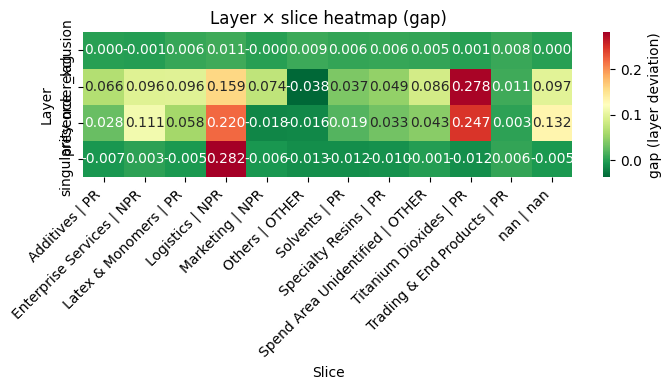

In [18]:
if anomalies is not None and not anomalies.empty:
    top_labels = top_cells["slice_label"].unique().tolist()
    subset = anomalies[anomalies["slice_label"].isin(top_labels)]

    heat_metric = "gap"  # or "z_plus" or "priority"

    heat_data = subset.pivot(
        index="layer_id",
        columns="slice_label",
        values=heat_metric,
    )

    plt.figure(figsize=(max(6, 0.6 * heat_data.shape[1]), 4))
    sns.heatmap(
        heat_data,
        cmap="RdYlGn_r",
        annot=True,
        fmt=".3f",
        cbar_kws={"label": f"{heat_metric} (layer deviation)"},
    )
    plt.xlabel("Slice")
    plt.ylabel("Layer")
    plt.title(f"Layer × slice heatmap ({heat_metric})")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()


This gives you a compact visual summary like the Streamlit heatmap, but with
the **most interesting slices** (by `priority`) on the x-axis.

---

## 9. Drilling down to cases in a problematic slice

Once you identify a problematic (layer, slice) pair, you can drill down to
individual cases by filtering `case_scores` on the slice attributes and
sorting by the relevant layer violation.

In [19]:
if anomalies is not None and not anomalies.empty:
    # Pick a specific anomaly from the table, e.g. first row
    row = top_cells.iloc[0]
    layer_id = row["layer_id"]
    slice_label = row["slice_label"]
    print("Investigating anomaly:", layer_id, "|", slice_label)

    # Parse the slice_label back into key columns
    # (depends on how you built it; here we split on ' | ')
    key_cols = [c for c in available_slice_cols if c in anomalies.columns]
    print("Key columns used:", key_cols)

    # Find the slice values for this label (from anomalies)
    slice_row = anomalies[anomalies["slice_label"] == slice_label].iloc[0]
    slice_filter = {col: slice_row[col] for col in key_cols}

    print("Slice filter:", slice_filter)

    # Build a boolean mask over df_sub
    mask = np.ones(len(df_sub), dtype=bool)
    for col, val in slice_filter.items():
        mask &= df_sub[col] == val

    cases_in_slice = df_sub.loc[mask, CASE_ID_COL].unique()
    print("Number of cases in slice:", len(cases_in_slice))

    # Filter case_scores to these cases and sort by the layer violation
    layer_col = f"violation_{layer_id}"
    bad_cases = (
        case_scores[case_scores[CASE_ID_COL].isin(cases_in_slice)]
        .sort_values(layer_col, ascending=False)
        .head(20)
    )
    bad_cases[[CASE_ID_COL, "score", layer_col]]

Investigating anomaly: singularity | Logistics | NPR
Key columns used: ['case Spend area text', 'case Spend classification text']
Slice filter: {'case Spend area text': 'Logistics', 'case Spend classification text': 'NPR'}
Number of cases in slice: 4919


Here you can see concrete cases to inspect further (e.g., in pm4py or another
tool), with their scores and layer violations.

---


## 10. Additional: SHAP / LIME explanations (optional)

Once you have a prioritised list of anomalies, you can use SHAP or LIME to
explain why certain cases or slices have high violation scores. For example:

- Pick a target: overall `score` or a specific `violation_<layer_id>`.
- Build a feature matrix `X` from case attributes (company, spend area, item
  type, duration bucket, day-of-week, etc.).
- Train a simple model, e.g. `RandomForestRegressor(X → target)`.
- Use `shap.Explainer(model, X)` to compute feature attributions for cases (or
  average attributions per slice).

These steps mirror what your Streamlit **Refinement** page does and can be
added as extra cells at the end of this notebook.

---

In [20]:
# ---- Target: choose one ----
TARGET_COL = "score"                # or e.g. "violation_singularity"
USE_BADNESS = True                  # if True, target = 1 - score

# Merge case-level attributes into case_scores
feature_cols = [c for c in SLICE_COLS if c in df_sub.columns]

case_attrs = df_sub[[CASE_ID_COL] + feature_cols].drop_duplicates()
data = case_scores.merge(case_attrs, on=CASE_ID_COL, how="left")

if TARGET_COL == "score" and USE_BADNESS:
    data["target"] = 1.0 - data["score"]   # badness
else:
    data["target"] = data[TARGET_COL].astype(float)

# Keep only cases with non-null target
data = data.dropna(subset=["target"])

print("Feature columns:", feature_cols)
print("Data shape:", data.shape)
data[feature_cols + ["score", "target"]].head()


Feature columns: ['case Spend area text', 'case Company', 'case Document Type', 'case Item Type', 'case Item Category', 'case Spend classification text', 'case Source', 'case GR-Based Inv. Verif.', 'case Goods Receipt']
Data shape: (248755, 32)


,case Spend area text,case Company,case Document Type,case Item Type,case Item Category,case Spend classification text,case Source,case GR-Based Inv. Verif.,case Goods Receipt,score,target
0,Packaging,companyID_0000,Standard PO,Standard,"3-way match, invoice before GR",PR,sourceSystemID_0000,False,True,0.891304,0.108696
1,Packaging,companyID_0000,Standard PO,Standard,"3-way match, invoice before GR",PR,sourceSystemID_0000,False,True,0.891304,0.108696
2,Packaging,companyID_0000,Standard PO,Standard,"3-way match, invoice before GR",PR,sourceSystemID_0000,False,True,0.891304,0.108696
3,Packaging,companyID_0000,Standard PO,Standard,"3-way match, invoice before GR",PR,sourceSystemID_0000,False,True,0.891304,0.108696
4,Packaging,companyID_0000,Standard PO,Standard,"3-way match, invoice before GR",PR,sourceSystemID_0000,False,True,0.949275,0.050725


In [21]:
# One-hot encode categorical features
X = pd.get_dummies(data[feature_cols], dummy_na=True)
y = data["target"].to_numpy()

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

rf = RandomForestRegressor(
    n_estimators=200,
    random_state=42,
    n_jobs=-1,
)
rf.fit(X_train, y_train)

print("Train R^2:", rf.score(X_train, y_train))
print("Test R^2:", rf.score(X_test, y_test))


Train R^2: 0.2635169054201021
Test R^2: 0.26286782777167084


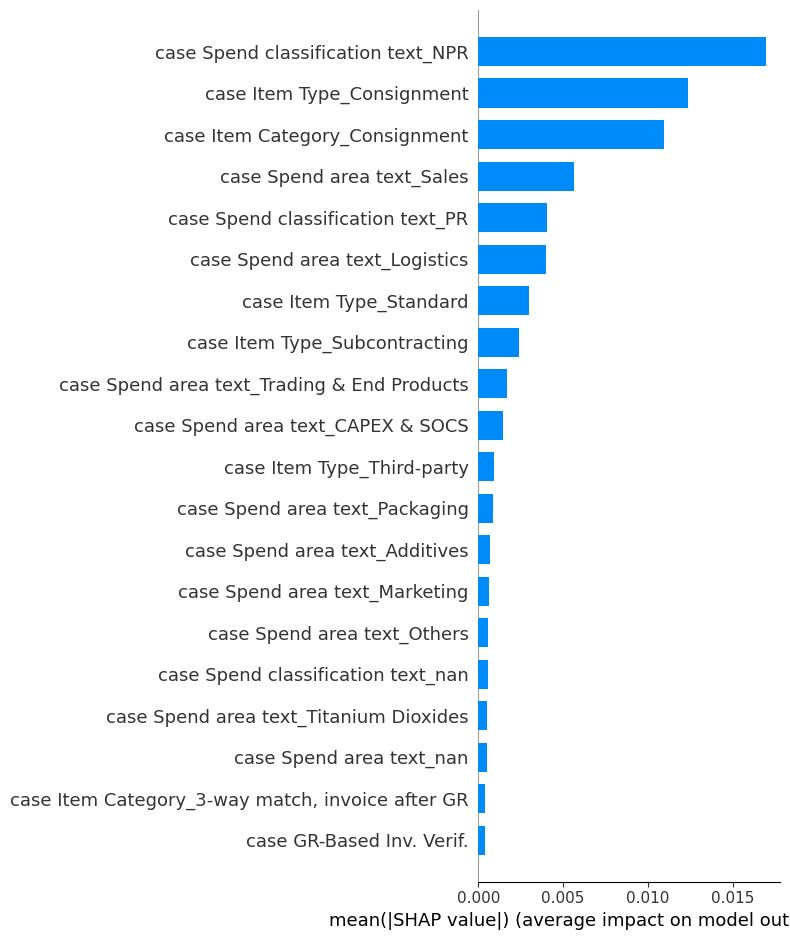

In [22]:
explainer = shap.TreeExplainer(rf)
shap_values = explainer(X_test)

# Summary bar plot: which features are most important overall?
shap.summary_plot(shap_values, X_test, plot_type="bar")


Worst case target: 0.5652173913043479


,case GR-Based Inv. Verif.,case Goods Receipt,case Spend area text_Additives,case Spend area text_CAPEX & SOCS,case Spend area text_Chemicals & Intermediates,case Spend area text_Commodity Resins,case Spend area text_Enterprise Services,case Spend area text_Latex & Monomers,case Spend area text_Logistics,case Spend area text_Marketing,...,"case Item Category_3-way match, invoice after GR","case Item Category_3-way match, invoice before GR",case Item Category_Consignment,case Item Category_nan,case Spend classification text_NPR,case Spend classification text_OTHER,case Spend classification text_PR,case Spend classification text_nan,case Source_sourceSystemID_0000,case Source_nan
59275,False,True,False,False,False,False,False,False,False,False,...,False,True,False,False,False,False,True,False,True,False


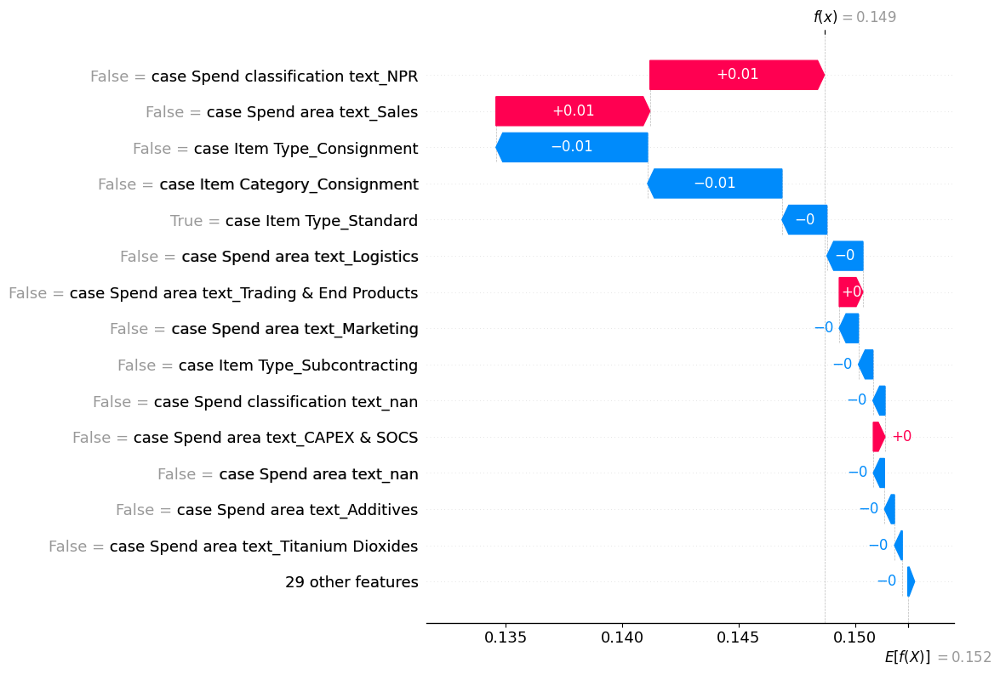

In [23]:
# Pick one of the worst test cases by target
idx_worst = np.argsort(-y_test)[0]
x_worst = X_test.iloc[[idx_worst]]

print("Worst case target:", y_test[idx_worst])
display(x_worst)

shap.plots.waterfall(shap_values[idx_worst], max_display=15)


In [24]:
iso = IsolationForest(
    n_estimators=200,
    contamination="auto",
    random_state=42,
    n_jobs=-1,
)

iso.fit(X)
outlier_score = -iso.score_samples(X)   # higher = more outlying

data["outlier_score"] = outlier_score

# Normalised for readability
if outlier_score.max() > outlier_score.min():
    data["outlier_score_norm"] = (outlier_score - outlier_score.min()) / (outlier_score.max() - outlier_score.min())
else:
    data["outlier_score_norm"] = 0.0

data[["outlier_score_norm", "target"]].describe()


,outlier_score_norm,target
count,248755.000000,248755.000000
mean,0.192798,0.152425
std,0.242565,0.121380
min,0.000000,0.000000
25%,0.024587,0.065217
50%,0.091636,0.108696
75%,0.178115,0.199275
max,1.000000,0.652174


In [25]:
# Top 20 most outlying cases
top_outliers = (
    data[[CASE_ID_COL, "outlier_score_norm", "score", "target"] + feature_cols]
    .sort_values("outlier_score_norm", ascending=False)
    .head(20)
)
top_outliers


,case concept:name,outlier_score_norm,score,target,case Spend area text,case Company,case Document Type,case Item Type,case Item Category,case Spend classification text,case Source,case GR-Based Inv. Verif.,case Goods Receipt
87318,4507026074_00010,1.000000,1.000000,0.000000,Others,companyID_0000,Standard PO,Service,"3-way match, invoice after GR",OTHER,sourceSystemID_0000,True,True
218739,4508066833_00010,1.000000,0.586957,0.413043,Others,companyID_0000,Standard PO,Service,"3-way match, invoice after GR",OTHER,sourceSystemID_0000,True,True
26484,4507008414_00010,1.000000,0.956522,0.043478,Others,companyID_0000,Standard PO,Service,"3-way match, invoice after GR",OTHER,sourceSystemID_0000,True,True
240023,4508073378_00010,1.000000,0.586957,0.413043,Others,companyID_0000,Standard PO,Service,"3-way match, invoice after GR",OTHER,sourceSystemID_0000,True,True
172048,4508051844_00010,1.000000,0.891304,0.108696,Others,companyID_0000,Standard PO,Service,"3-way match, invoice after GR",OTHER,sourceSystemID_0000,True,True
16170,4507005429_00010,1.000000,0.978623,0.021377,Others,companyID_0000,Standard PO,Service,"3-way match, invoice after GR",OTHER,sourceSystemID_0000,True,True
41213,4507012954_00010,1.000000,0.990580,0.009420,Others,companyID_0000,Standard PO,Service,"3-way match, invoice after GR",OTHER,sourceSystemID_0000,True,True
212148,4508064768_00010,0.991867,1.000000,0.000000,Others,companyID_0000,Standard PO,Third-party,"3-way match, invoice after GR",OTHER,sourceSystemID_0000,True,True
154768,4508046710_00050,0.991867,0.934783,0.065217,Others,companyID_0000,Standard PO,Third-party,"3-way match, invoice after GR",OTHER,sourceSystemID_0000,True,True
219208,4508067000_00010,0.970137,0.652174,0.347826,Marketing,companyID_0000,Standard PO,Service,"3-way match, invoice after GR",NPR,sourceSystemID_0000,True,True


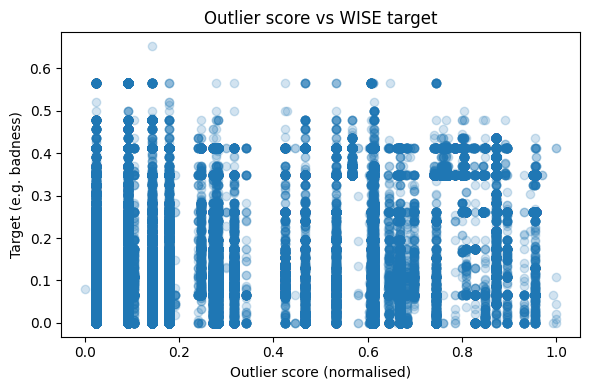

In [26]:
plt.figure(figsize=(6, 4))
plt.scatter(data["outlier_score_norm"], data["target"], alpha=0.2)
plt.xlabel("Outlier score (normalised)")
plt.ylabel("Target (e.g. badness)")
plt.title("Outlier score vs WISE target")
plt.tight_layout()
plt.show()


## 11. Extra dependencies for `requirements.txt`

To run this notebook, in addition to your current WISE dependencies, you will
need at least:

```text
# Jupyter / notebook (if not already installed)
jupyter
notebook
ipykernel

# Process mining
pm4py>=2.7.10

# Visualisation
matplotlib
seaborn

# ML / explanation
scikit-learn
shap
plotly
ipywidgets

```


You can append these lines to your existing `requirements.txt` and reinstall
your environment.

---

This notebook brings together the main WISE ideas — norms, scoring, slice
prioritisation, and anomaly ranking — and allows you to drive the analysis
from Python, either on the full BPIC 2019 log or on a selected subset
corresponding to one of the three process types mentioned by the data
provider.